# **Análisis Exploratorio Inicial de Datos**

In [2]:
#########################
# ---- Depdendencies ----
#########################

# system
import os
import sys
import pathlib
from dotenv import load_dotenv

# standard libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# image processing
from PIL import Image

# DeepLearning modeling
import torch
import torchvision
import torchaudio

# Environment variables loading
sys.path.append(os.path.abspath(os.path.join("..", "src")))
from core.load_env import EnvLoader
from utils.utils import *
env = EnvLoader()

# EDA related functions
from eda.analyze_feature import *
from eda.explore_distribution import *
from eda.validate_dataset import *
from eda.view_samples import *

# Data modification/augmentation functions
from pipelines.preprocess import split_and_balance_dataset
from utils.image_modifier import ImageAugmentor

# Model builders and trainers
from builders.builders import ModelBuilder
from pipelines.train import train 

# Recarga automatica de dependencias
%load_ext autoreload
%autoreload 2

# Cuda availability
print("*"*60)
check_cuda_availability()

# Data folder detections
from core.path_finder import ProjectPaths
from adapters.data_loader import *

print("*"*60)
pp = ProjectPaths()
print(pp.get_data_path())          # Ruta absoluta a data/
print(pp.get_structure())          # Diccionario con la estructura
pp.summary()                       # Pretty print de la estructura

************************************************************
⚡⚡ Verificando si la GPU está disponible... ⚡⚡

🔹 Verificando GPU en PyTorch 🔹
✅ ¡La GPU está disponible! PyTorch puede usar CUDA 🎉🚀
   💻 Nombre de la GPU: NVIDIA GeForce RTX 4060 Laptop GPU

🔹 Verificando GPU en TensorFlow 🔹
📌 TensorFlow version: 2.10.0
⚙️ Built with CUDA: True 🌟
⚙️ Built with cuDNN: True 🌟

🎯 ¡TensorFlow puede usar la GPU con CUDA y cuDNN! 🚀🔥
************************************************************
C:\CodeProjects\CV\micro_corn_diseases_detection\data
{'processed': 'C:\\CodeProjects\\CV\\micro_corn_diseases_detection\\data\\processed', 'raw': {'data': {'Blight': 'C:\\CodeProjects\\CV\\micro_corn_diseases_detection\\data\\raw\\data\\Blight', 'Common_Rust': 'C:\\CodeProjects\\CV\\micro_corn_diseases_detection\\data\\raw\\data\\Common_Rust', 'Gray_Leaf_Spot': 'C:\\CodeProjects\\CV\\micro_corn_diseases_detection\\data\\raw\\data\\Gray_Leaf_Spot', 'Healthy': 'C:\\CodeProjects\\CV\\micro_corn_diseases_detecti

In [28]:
#-----------------------
# ---- Data loading ----
#-----------------------

raw_dataset = load_raw_data()

Se cargaron 1145 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Blight'.
Se cargaron 1306 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Common_Rust'.
Se cargaron 1174 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Gray_Leaf_Spot'.
Se cargaron 1162 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Healthy'.
✅ Las imágenes de todas las categorías se han cargado exitosamente


************************************************************
 Data category Blight


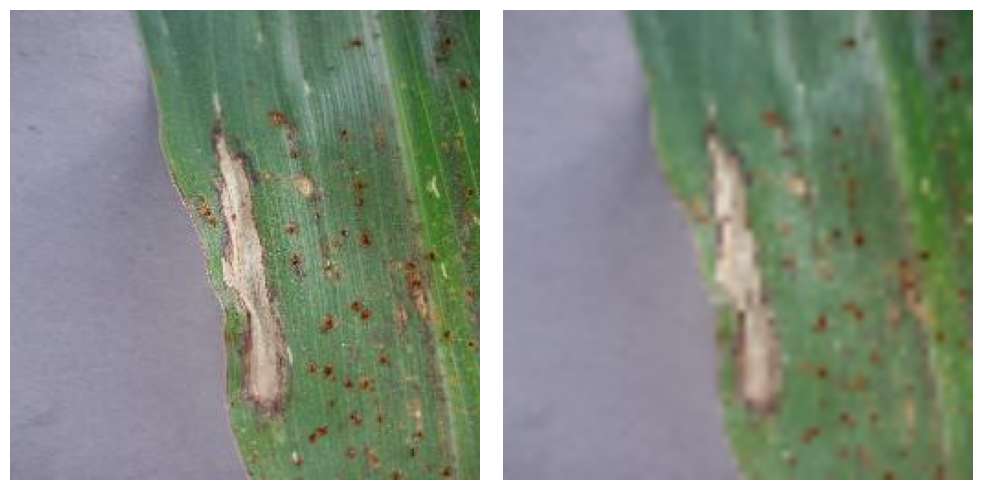

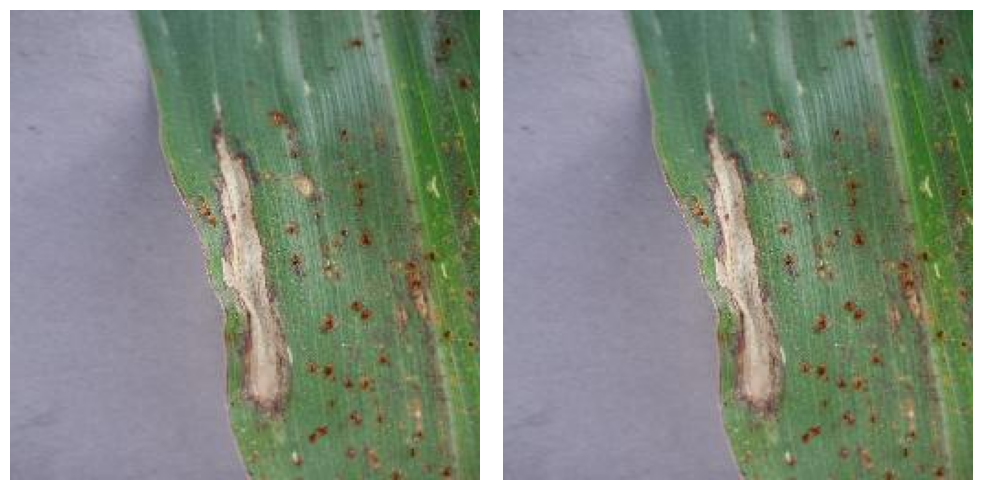

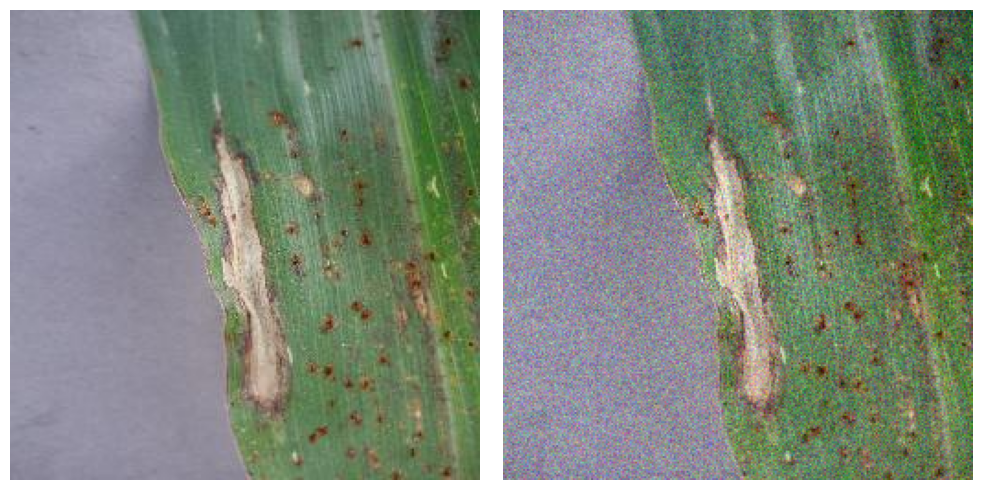

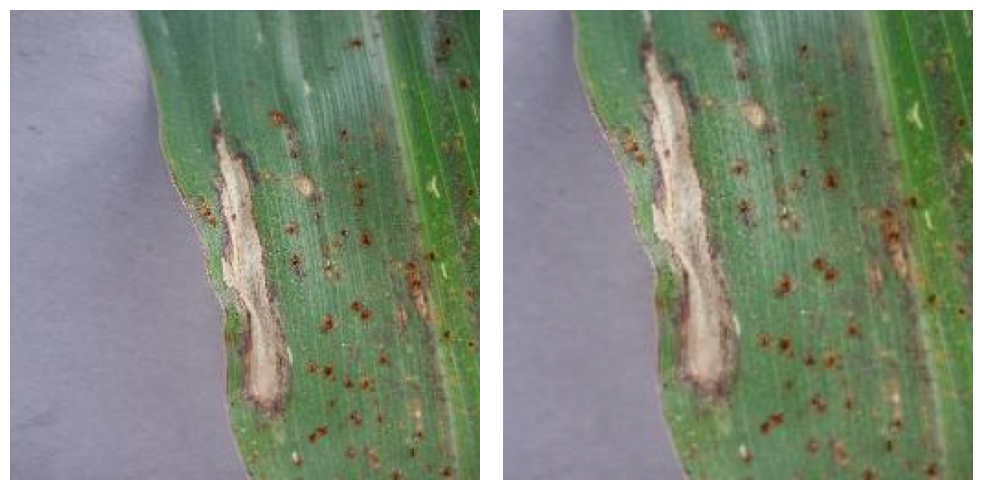

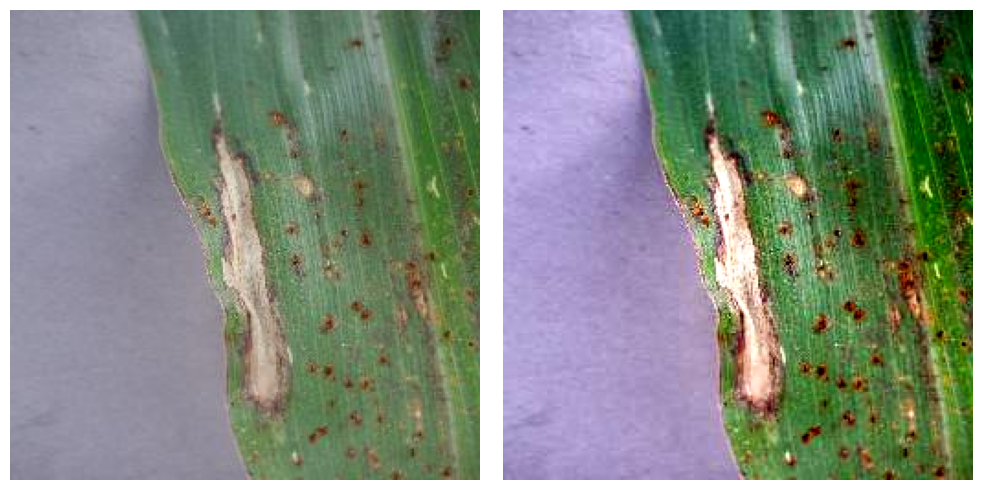

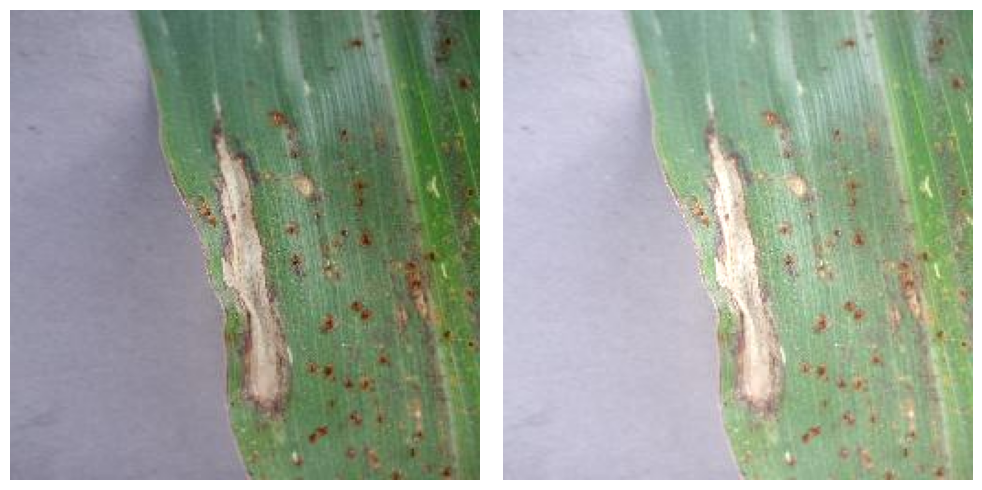

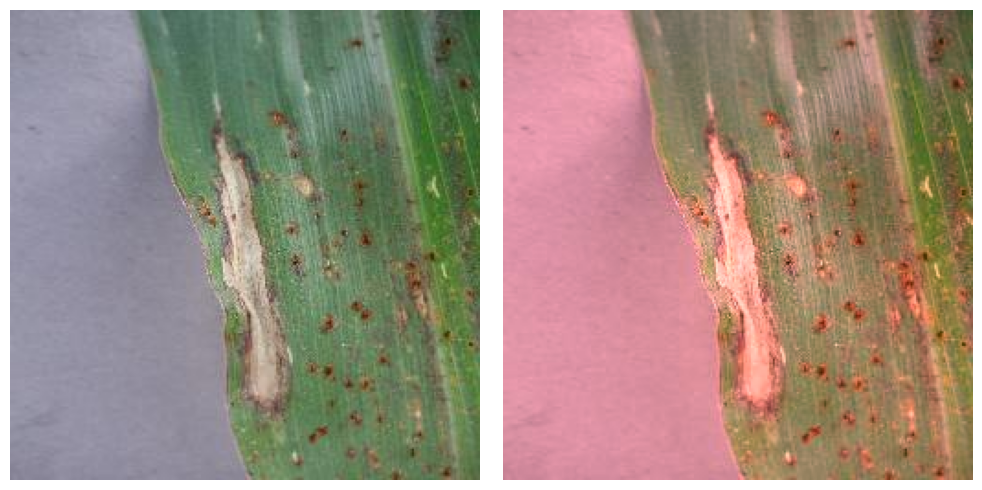

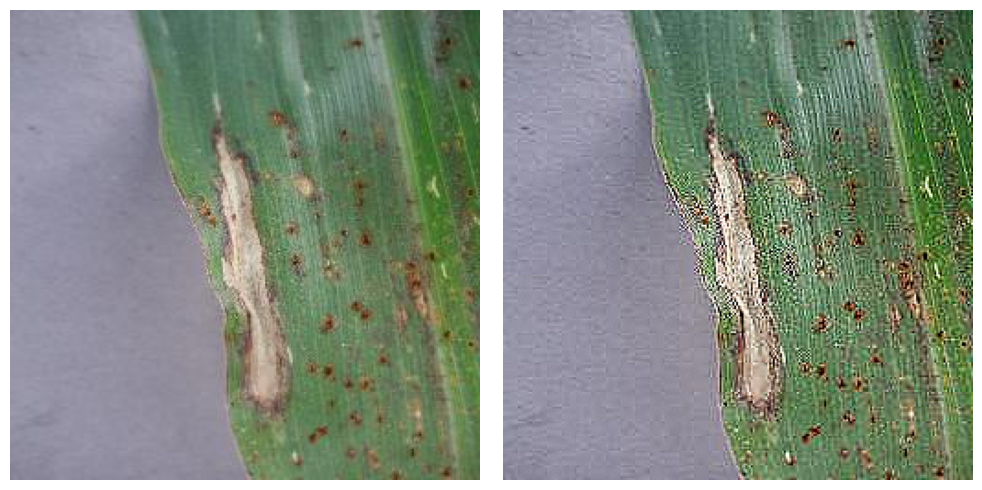

************************************************************
 Data category Common_Rust


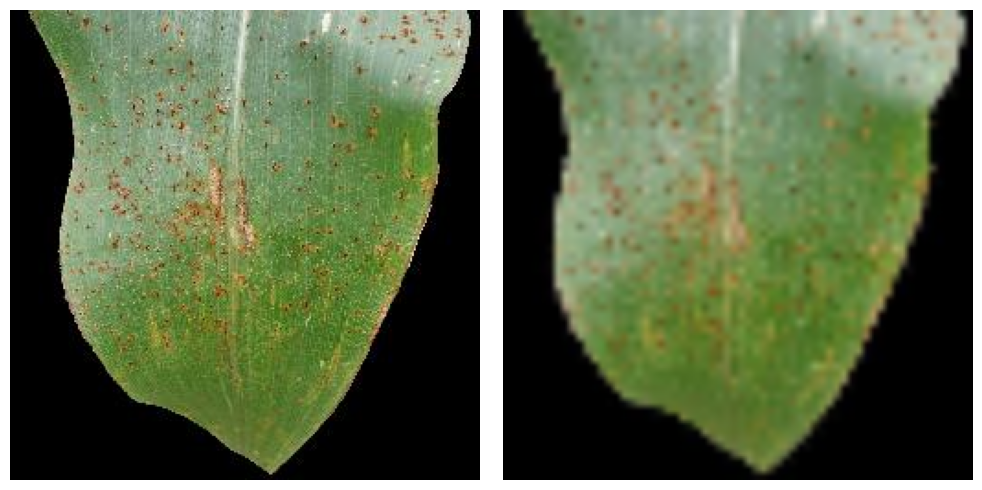

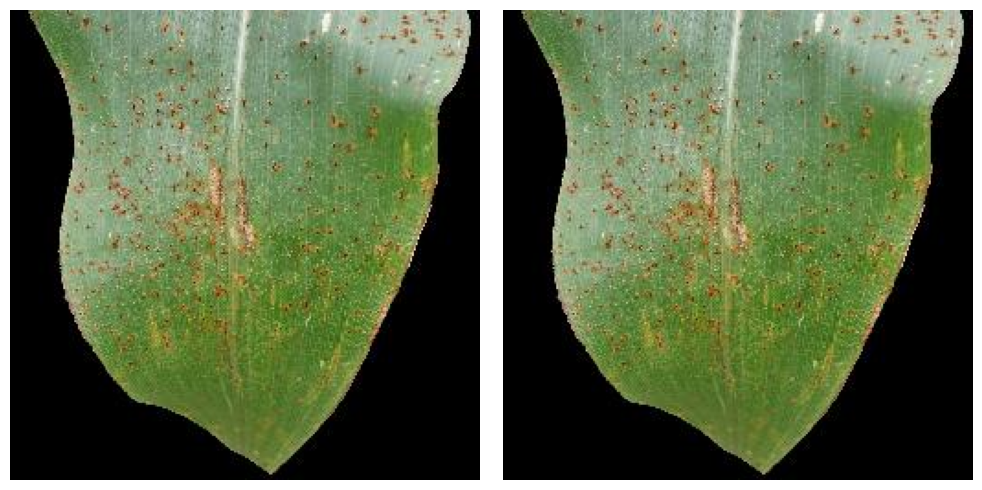

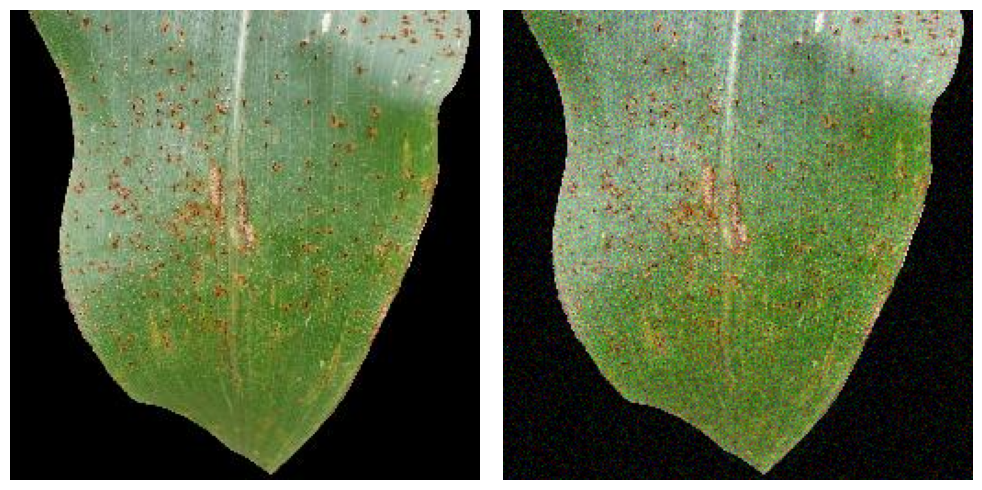

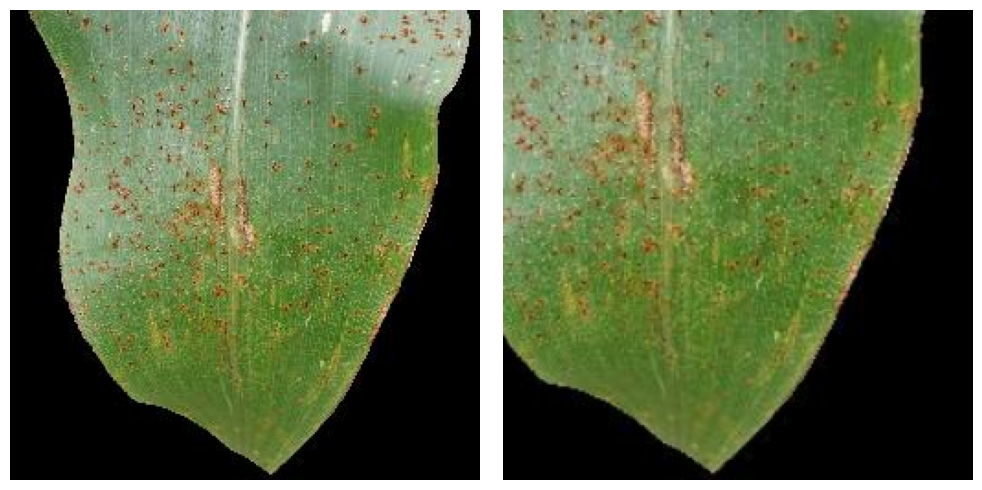

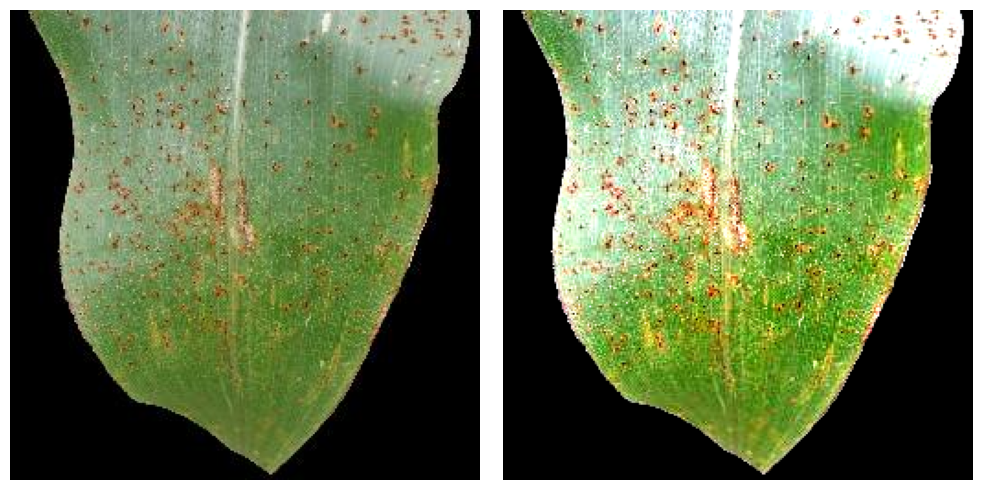

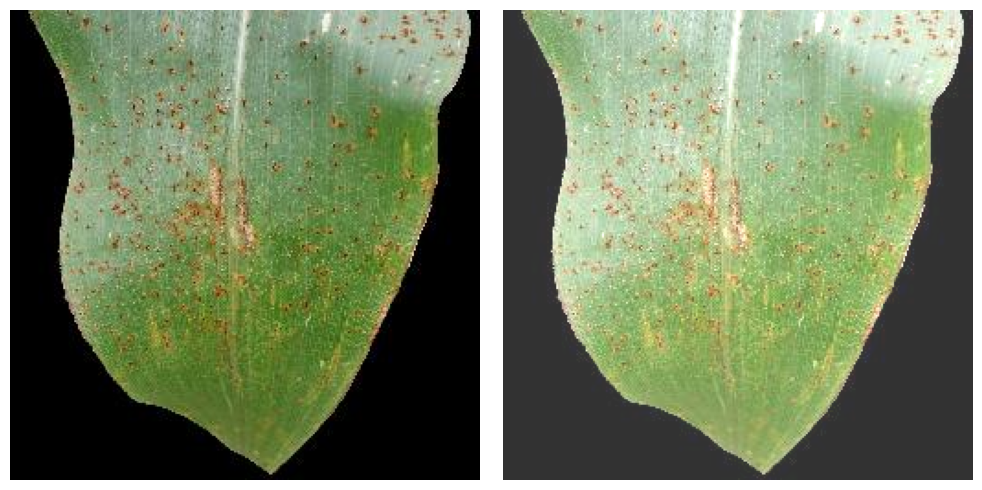

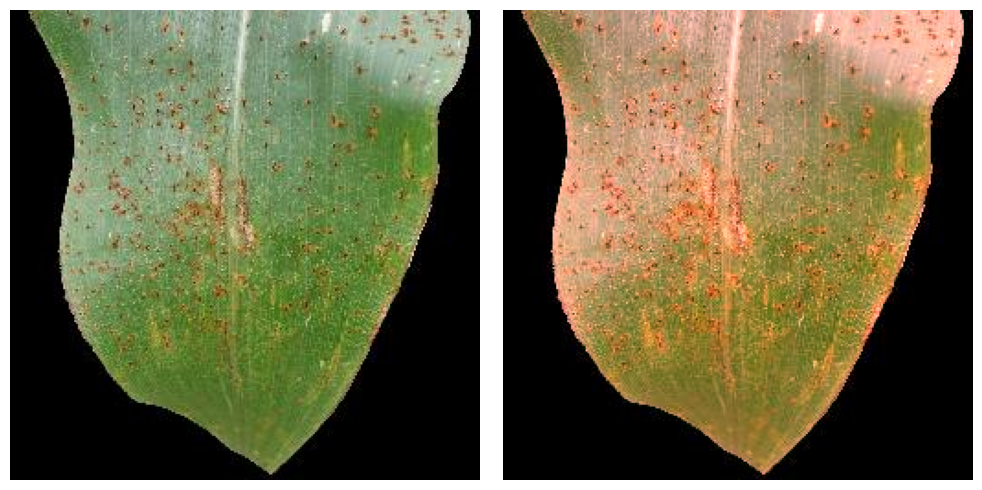

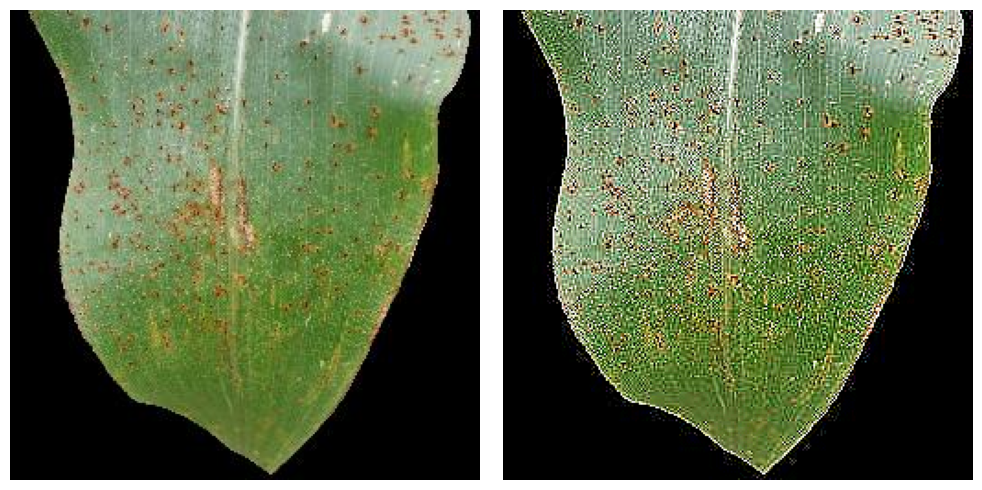

************************************************************
 Data category Gray_Leaf_Spot


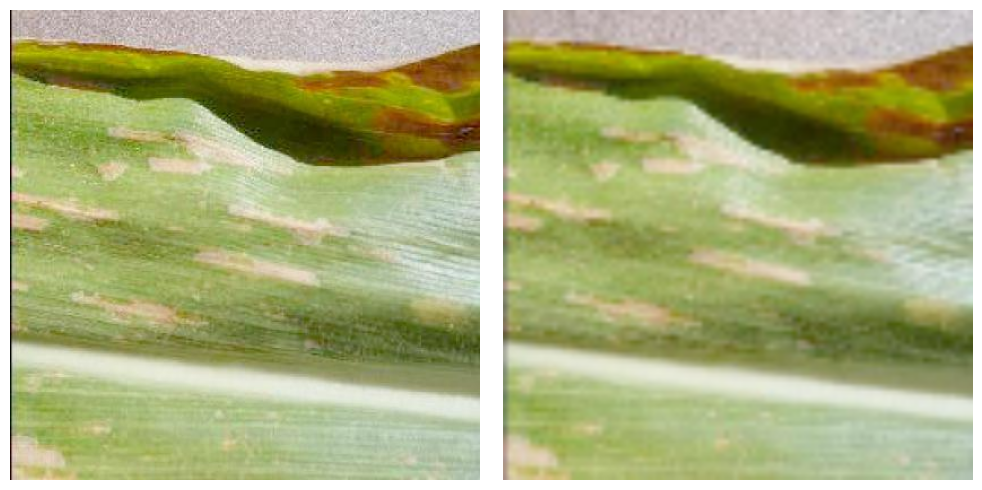

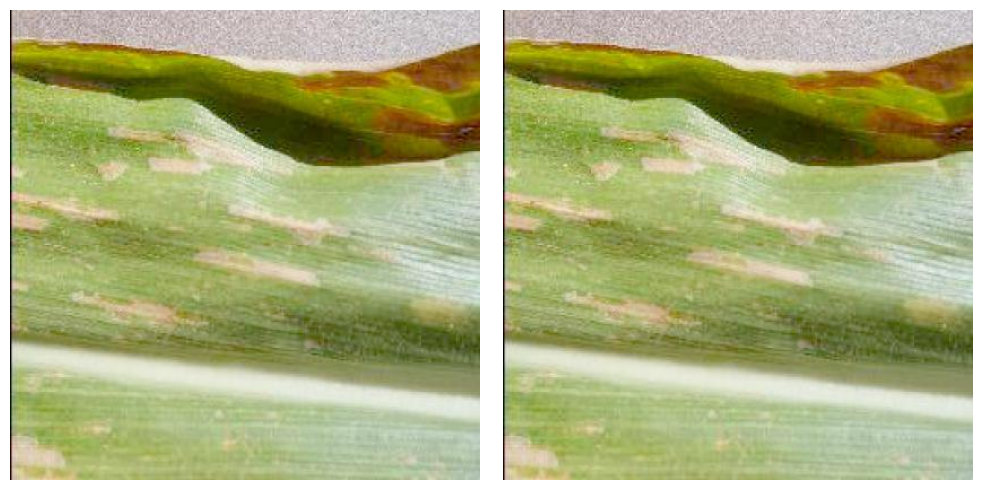

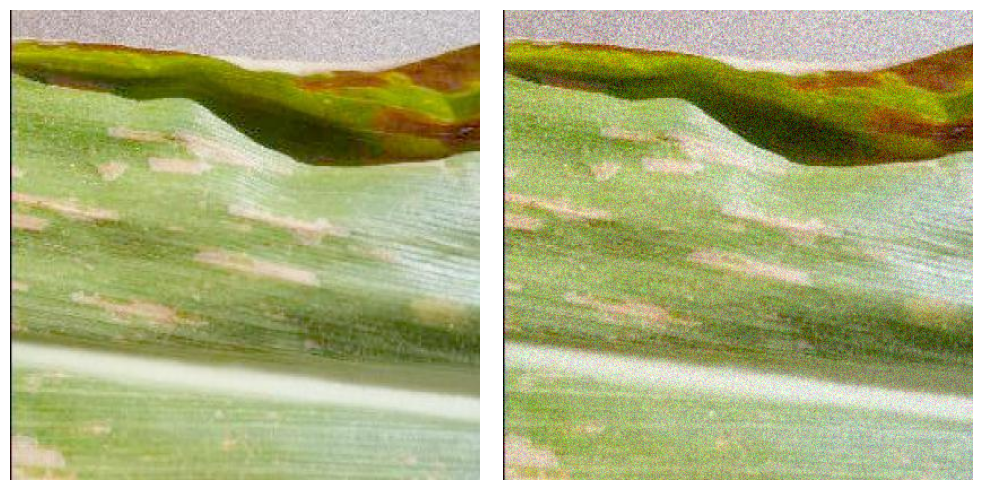

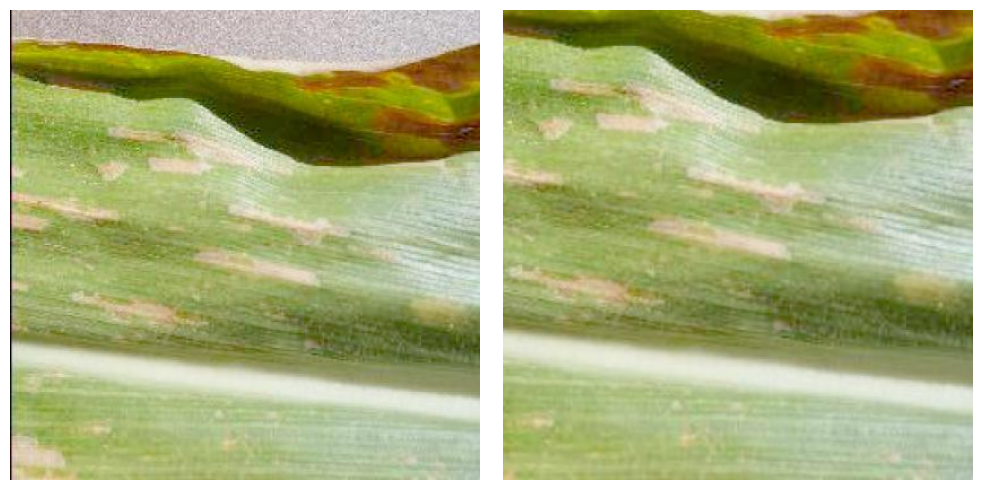

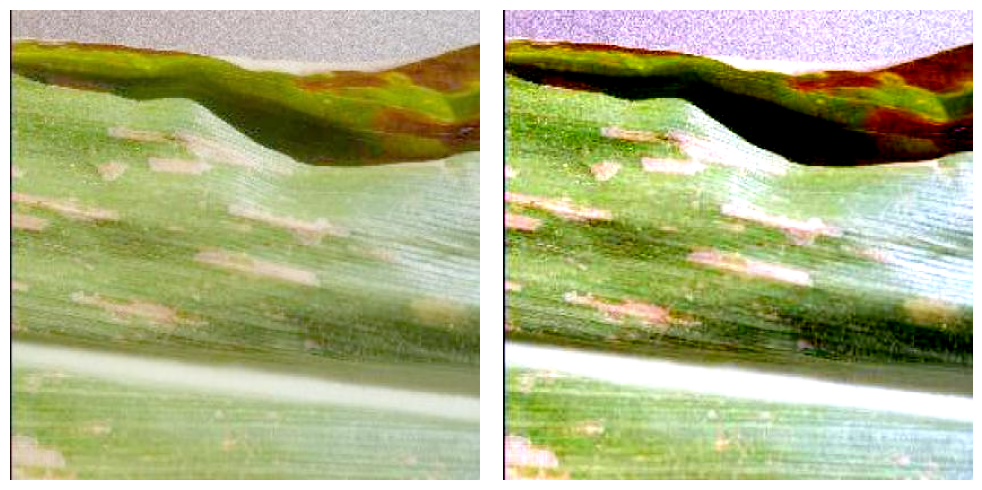

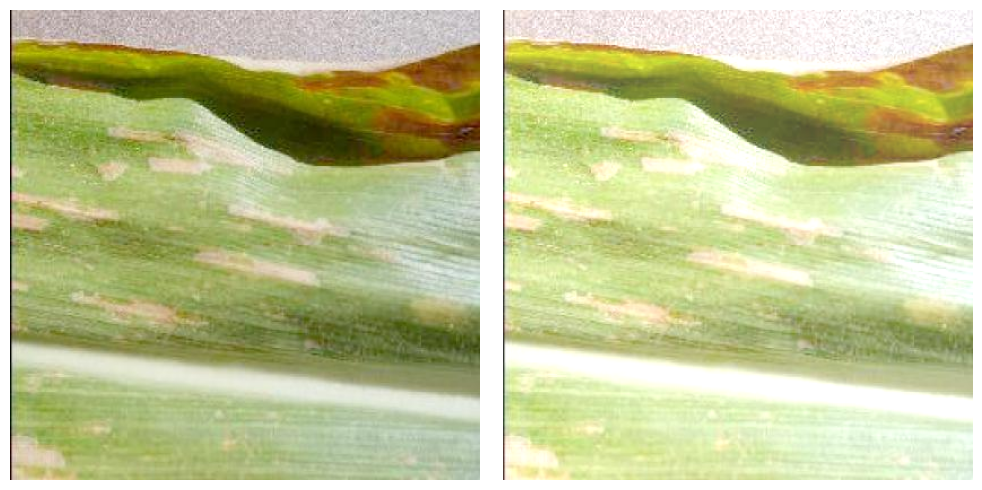

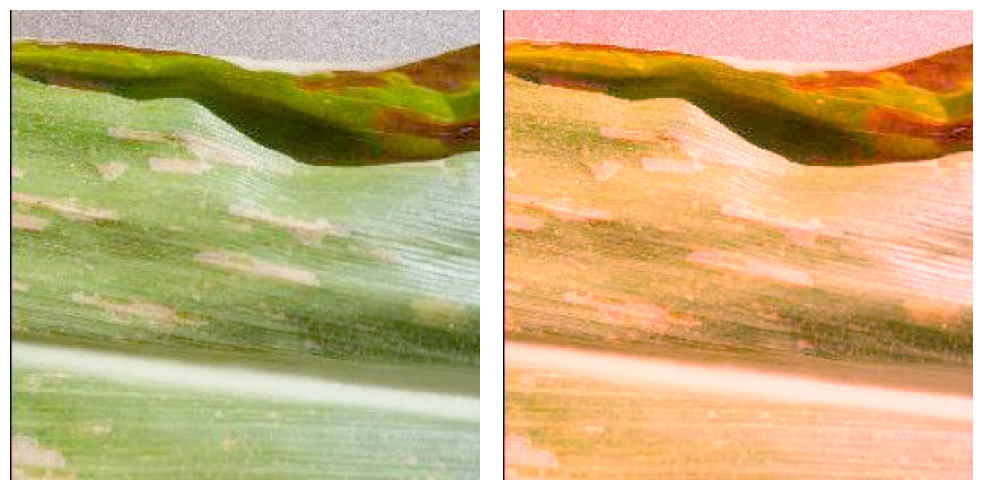

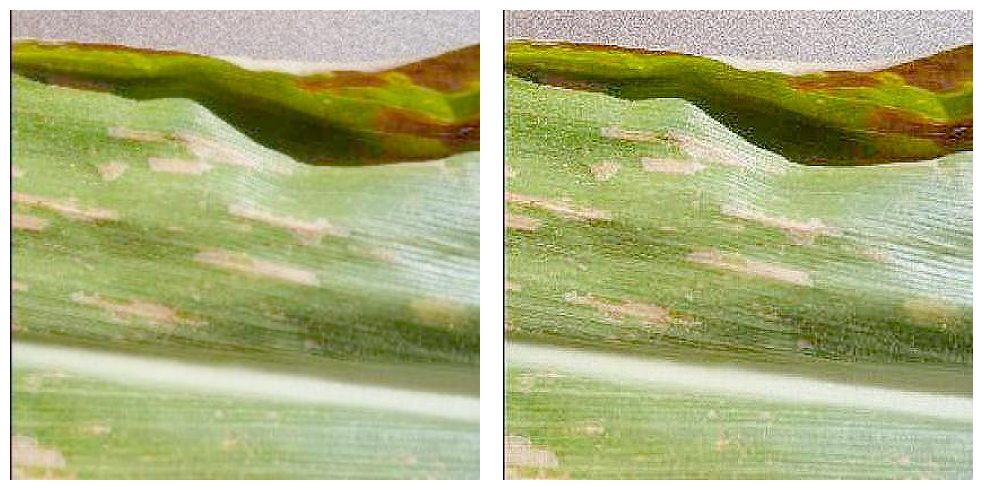

************************************************************
 Data category Healthy


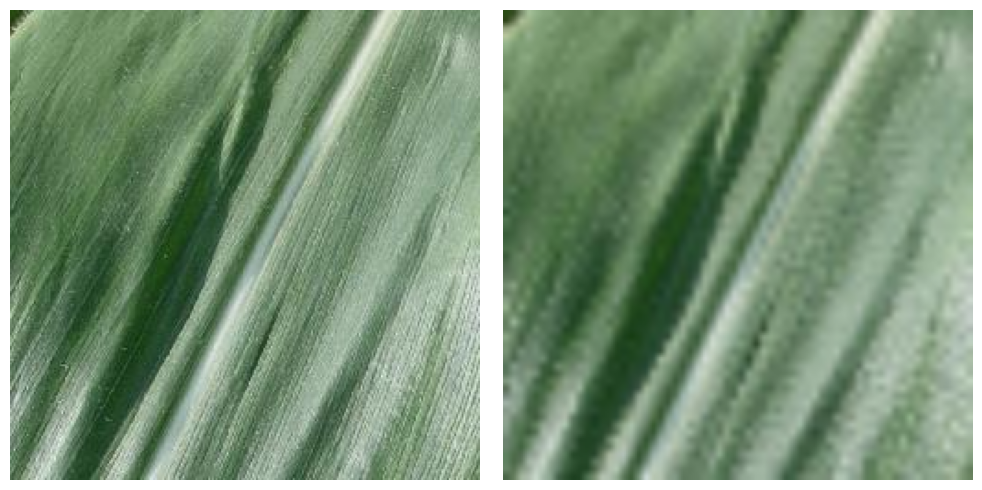

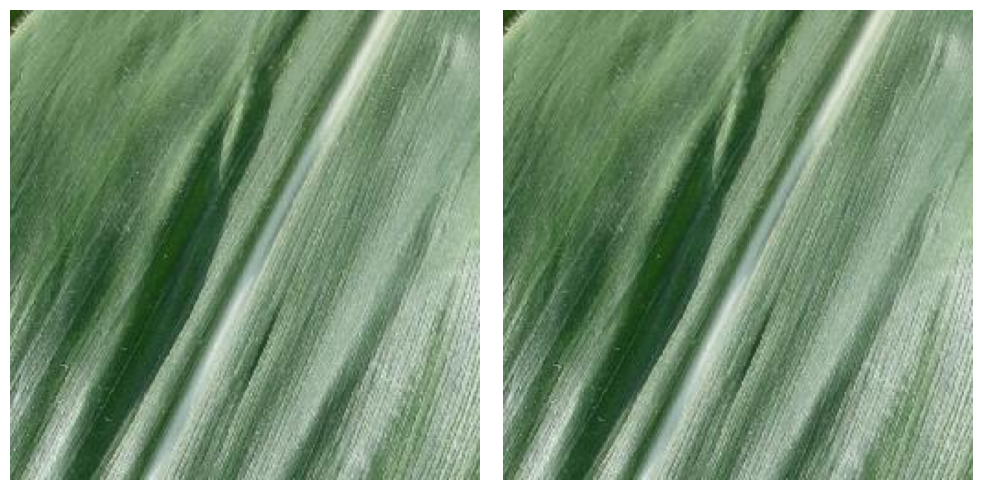

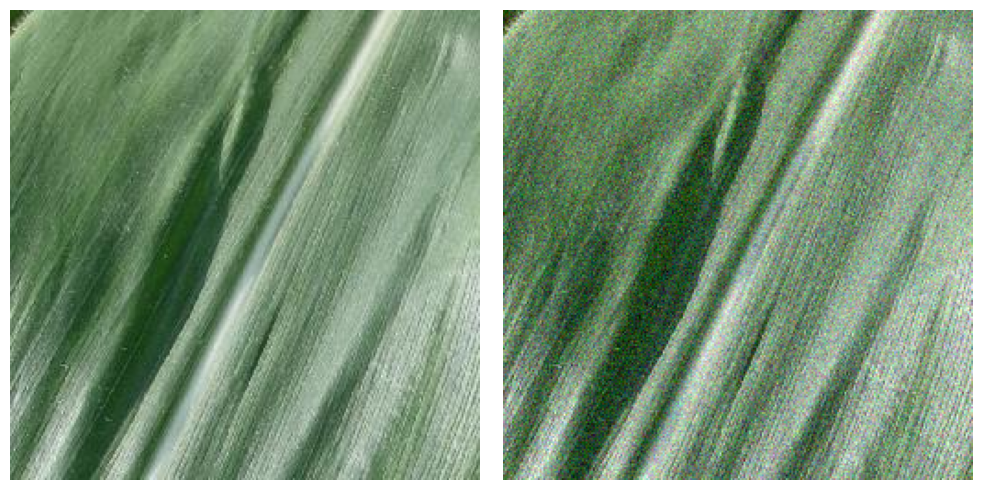

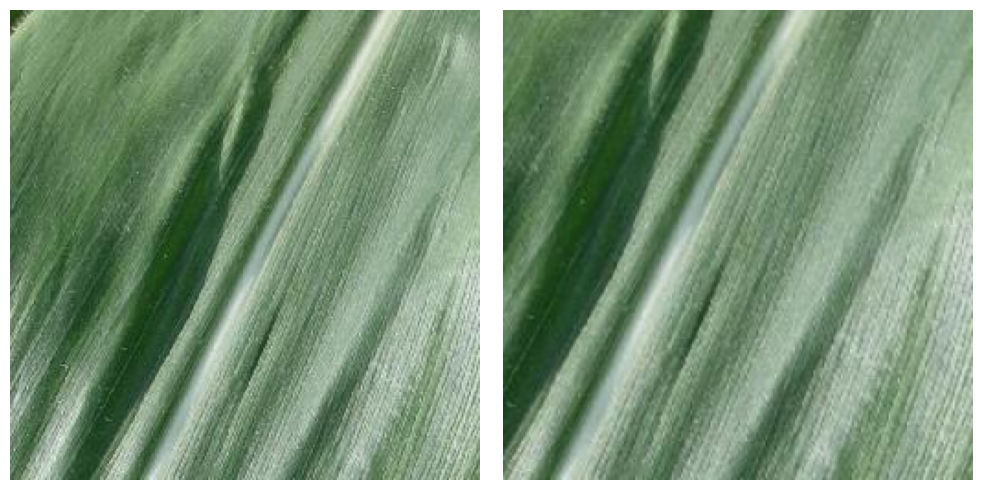

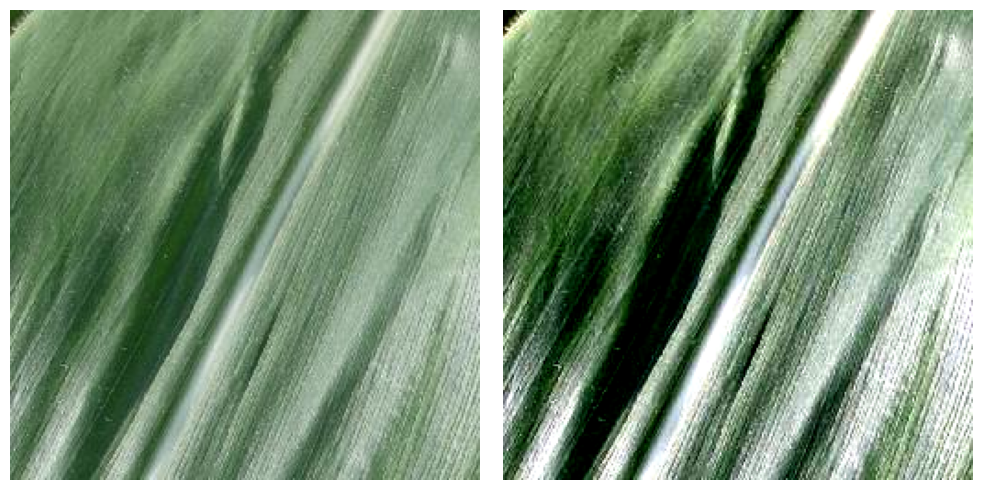

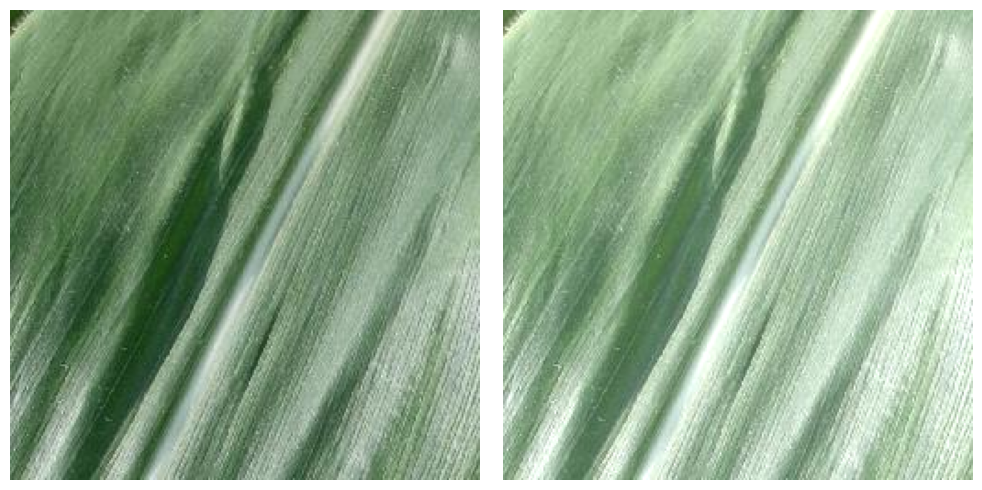

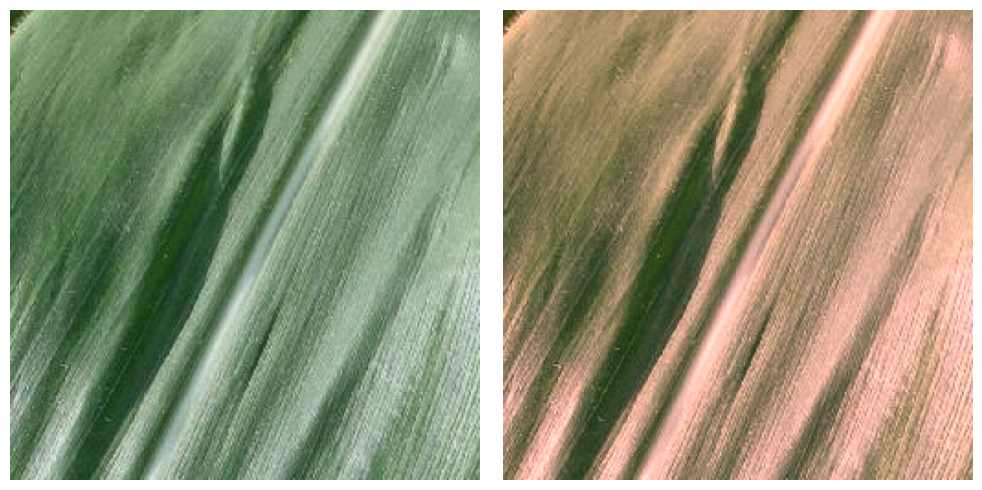

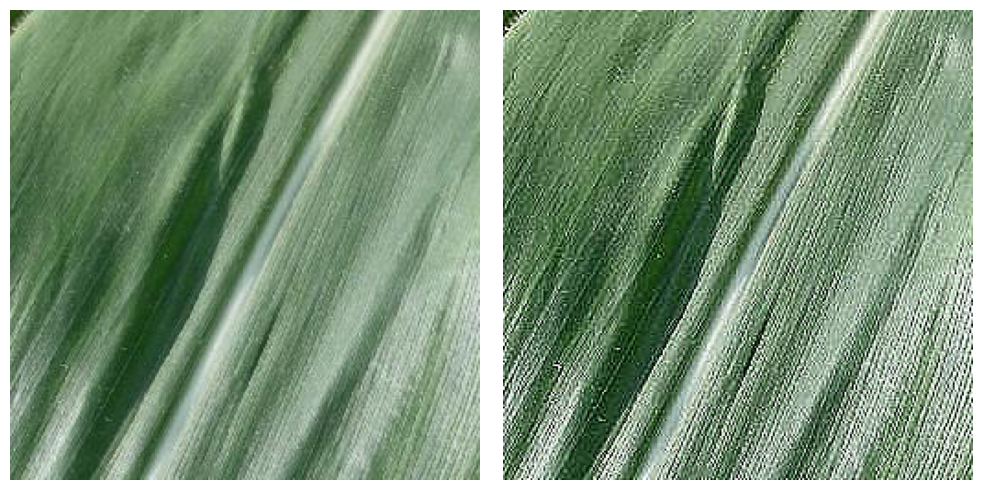

In [55]:
#-----------------------------------
# ---- Image manipulation tests ----
#-----------------------------------

manipulator = ImageAugmentor()
image_num = 7

test_images = [raw_dataset[type_][7] for type_ in raw_dataset.keys()]

for type_ in raw_dataset.keys():
    print('*'*60)
    print(f' Data category {type_}')
    original_image = raw_dataset[type_][image_num]
    image_down = manipulator.downsample(original_image, factor=4)
    image_dis  = manipulator.distort(original_image, factor=1000, axis='horizontal')
    image_noise= manipulator.add_noise(original_image, amount=40)
    image_chop = manipulator.chop(original_image, x1=50, y1=50, x2=None, y2=None)
    image_contrast = manipulator.adjust_contrast(original_image, factor=2)
    image_bright = manipulator.adjust_brightness(original_image, delta=50)
    image_intensity = manipulator.adjust_color_intensity(original_image, channel=0, factor=1.5)
    image_sharp = manipulator.adjust_sharpness(original_image, amount=1.0)

    images_to_plot_1 = [original_image, image_down]
    images_to_plot_2 = [original_image, image_dis]
    images_to_plot_3 = [original_image, image_noise]
    images_to_plot_4 = [original_image, image_chop]
    images_to_plot_5 = [original_image, image_contrast]
    images_to_plot_6 = [original_image, image_bright]
    images_to_plot_7 = [original_image, image_intensity]
    images_to_plot_8 = [original_image, image_sharp]
    plot_images(images_to_plot_1)
    plot_images(images_to_plot_2)
    plot_images(images_to_plot_3)
    plot_images(images_to_plot_4)
    plot_images(images_to_plot_5)
    plot_images(images_to_plot_6)
    plot_images(images_to_plot_7)
    plot_images(images_to_plot_8)

In [4]:
#-----------------------------------
# ---- Data Balancing and split ----
#-----------------------------------

balanced_dataset = split_and_balance_dataset(split_ratios= (0.7, 0.15, 0.15), balanced = True)


📦 Llamando a la función de carga de datos...
Se cargaron 1145 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Blight'.
Se cargaron 1306 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Common_Rust'.
Se cargaron 1174 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Gray_Leaf_Spot'.
Se cargaron 1162 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Healthy'.
✅ Las imágenes de todas las categorías se han cargado exitosamente
✅ Carga de datos completada.

⚖️  Modo balanceado: Todas las clases se reducirán a 1145 imágenes.

✅ Proceso de división completado exitosamente.
📊 Resumen de la Distribución Final:
Clase                |   Train |     Val |    Test |   Total
------------------------------------------------------------
Blight               |     801 |     171 |     173 |    1145
Common_Rust          |     801 |     171 |     173 |    1145
Gray_Leaf_Spot       |     

In [3]:
#-----------------------------
# ---- VGG16 Fine tunning ----
#-----------------------------

tuner_instance, test_data_sets = train(
        split_ratios=(0.7, 0.15, 0.15),
        balanced=True
    )

mlruns directory = c:\CodeProjects\CV\micro_corn_diseases_detection\models\mlruns
📂 Tracking URI actual: file:///c:/CodeProjects/CV/micro_corn_diseases_detection/models/mlruns
Iniciando el proceso de entrenamiento y búsqueda de hiperparámetros...
Dataset de origen: raw
Número de clases: 4

📦 Cargando y preparando los datos en memoria...

📦 Llamando a la función de carga de datos...
Se cargaron 1145 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Blight'.
Se cargaron 1306 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Common_Rust'.
Se cargaron 1174 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Gray_Leaf_Spot'.
Se cargaron 1162 imágenes desde 'C:\CodeProjects\CV\micro_corn_diseases_detection\data\raw\data\Healthy'.
✅ Las imágenes de todas las categorías se han cargado exitosamente
✅ Carga de datos completada.

⚖️  Modo balanceado: Todas las clases se reducirán a 1145 imágenes.

✅ Proceso de di